<a href="https://colab.research.google.com/github/YounSooKimTech/Joy_Profile_Photos/blob/main/Columbia_University_Preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Meta Dataset

## Econ Department

In [ ]:
import pandas as pd
import requests
from bs4 import BeautifulSoup

# Econ Department
urls = []

econ_url = "https://business.columbia.edu/directory/departments/economics"
response = requests.get(econ_url)
soup = BeautifulSoup(response.content, 'html.parser')
#print(url, "\t", response)

name_tags = soup.find_all("h3", class_="m-listing-faculty__title")

for a_name_tag in name_tags:
  name = a_name_tag.get_text().strip()

  new_name = name.lower().replace(" ", "-").replace(".", "")

  if new_name == "cristóbal-otero":
    new_name = "cristobal-otero-ruiz-tagle"

  elif new_name == "thomas--prusa":
    new_name = "thomas-prusa"
  elif new_name == "nishat-a-juy":
    new_name = "nishat-juy"


  url = f"https://business.columbia.edu/faculty/people/{new_name}"
  response = requests.get(url)

  if response.status_code == 404:
    url = f"https://business.columbia.edu/staff/people/{new_name}"
    response = requests.get(url)

  else:
    url = url
    response = response

  #print(name, url, response)
  urls.append(url)

In [ ]:
# From personal page, extract information

df_names = []
df_titles =[]
df_departments = []
df_bios = []
df_urls = []

for url in urls:
  response = requests.get(url)
  soup = BeautifulSoup(response.content, "html.parser")

  name = soup.find("h1", class_ = "o-profile__name").get_text().strip()
  df_names.append(name)

  info_tag = soup.find("div", class_="field field-person-title-affiliations field__items")
  title = info_tag.find("dt", class_ = "m-detail-meta__item-title").get_text().strip()
  department = info_tag.find("dd", class_="m-detail-meta__item-content").get_text().strip()

  prof_text = soup.find("div", class_ = "o-profile__content").get_text().strip()

  df_titles.append(title)
  df_departments.append(department)
  df_bios.append(prof_text)
  df_urls.append(url)

  #print(name, prof_text, "\n")

In [ ]:
df_0 = pd.DataFrame({"Name":df_names,
                        "Title":df_titles,
                        "Department":df_departments,
                        "URL":df_urls,
                        "Biography":df_bios})
print(df_0.info())
df_0.head(2)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64 entries, 0 to 63
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        64 non-null     object
 1   Title       64 non-null     object
 2   Department  64 non-null     object
 3   URL         64 non-null     object
 4   Biography   64 non-null     object
dtypes: object(5)
memory usage: 2.6+ KB
None


,Name,Title,Department,URL,Biography
0,Sadhika Bagga,Postdoctoral Research Scholar in the Faculty o...,Economics Division,https://business.columbia.edu/faculty/people/s...,
1,Akeem Baird,Administrative Assistant,Economics Division,https://business.columbia.edu/staff/people/ake...,


## Non-Econ Department

In [ ]:
# Get url for personal page
urls = []

import pandas as pd
import requests
from bs4 import BeautifulSoup

departments = ["management", "dro", "marketing", "accounting", "finance"]

for department in departments:
  department_url = f"https://business.columbia.edu/faculty/divisions/{department}/faculty"
  response = requests.get(department_url)
  soup = BeautifulSoup(response.content, 'html.parser')
  #print(department_url, "\t", response)

  # Prof name in the department page
  name_tags = soup.find_all("h3", class_="m-listing-faculty__title")

  for tag in name_tags:
      name = tag.get_text().strip()
      new_name = name.lower().replace(" ", "-").replace(".", "").replace("(", "").replace(")", "")
      #print(new_name)

      # Error handling
      if new_name == "emmanuel-a-yimfor":
        new_name = "emmanuel-yimfor"
      elif new_name == "chris-lasala":
        new_name = "christopher-lasala"

      elif new_name == "lynne-sagalyn":
        prof_url = "https://business.columbia.edu/staff/people/lynne-sagalyn"
      elif new_name == "hannah-li":
        prof_url = "https://business.columbia.edu/staff/people/hannah-li"

      else:
        prof_url = f'https://business.columbia.edu/faculty/people/{new_name}'

        response = requests.get(prof_url)
        #print(prof_url, response)

      urls.append(prof_url)

In [ ]:
# From personal page, extract information
df_names = []
df_titles = []
df_departments = []
df_bios = []
df_urls = []


for url in urls:
  response = requests.get(url)
  soup = BeautifulSoup(response.content, "html.parser")

  name = soup.find("h1", class_ = "o-profile__name").get_text().strip()

  info_tag = soup.find("div", class_="field field-person-title-affiliations field__items")
  title = info_tag.find("dt", class_ = "m-detail-meta__item-title").get_text().strip()
  department = info_tag.find("dd", class_="m-detail-meta__item-content").get_text().strip()

  prof_text = soup.find("div", class_ = "o-profile__content").get_text().strip()
  #print(prof_text)

  df_names.append(name)
  df_titles.append(title)
  df_departments.append(department)
  df_bios.append(prof_text)
  df_urls.append(url)

In [ ]:
df_1 = pd.DataFrame({"Name":df_names,
                        "Title":df_titles,
                        "Department":df_departments,
                        "URL":df_urls,
                        "Biography":df_bios})


print(df_1.info(), "\n")
df_1.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144 entries, 0 to 143
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        144 non-null    object
 1   Title       144 non-null    object
 2   Department  144 non-null    object
 3   URL         144 non-null    object
 4   Biography   144 non-null    object
dtypes: object(5)
memory usage: 5.8+ KB
None 



,Name,Title,Department,URL,Biography
0,Mabel Abraham,Barbara and Meyer Feldberg Associate Professor...,Management Division,https://business.columbia.edu/faculty/people/m...,Mabel Abraham is the Barbara and Meyer Feldber...
1,Eric Abrahamson,Hughie E. Mills Professor of Business,Management Division,https://business.columbia.edu/faculty/people/e...,"Professor Abrahamson studies the creation, spr..."
2,Modupe Akinola,Barbara and David Zalaznick Professor of Business,Management Division,https://business.columbia.edu/faculty/people/m...,Modupe Akinola is the Barbara and David Zalazn...
3,Daniel Ames,Ting Tsung and Wei Fong Chao Professor of Busi...,Management Division,https://business.columbia.edu/faculty/people/d...,Professor Ames's research focuses on social ju...
4,Joel Brockner,Phillip Hettleman Professor of Business,Management Division,https://business.columbia.edu/faculty/people/j...,Within the broader field of organizational beh...


## Merge two dataframes

In [ ]:
df_total = pd.concat([df_0, df_1], ignore_index=True)

df_total.loc[df_total["Name"] == "Eli Noam", "Title"] = "Emeritus"
df_total.loc[df_total["Name"] == "Jason Buckweitz", "Title"] = "Adjunct"
df_total.loc[df_total["Name"] == "R.A. Farrokhnia", "Title"] = "Adjunct"

df_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 208 entries, 0 to 207
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        208 non-null    object
 1   Title       208 non-null    object
 2   Department  208 non-null    object
 3   URL         208 non-null    object
 4   Biography   208 non-null    object
dtypes: object(5)
memory usage: 8.2+ KB


## Filter the dataset

In [ ]:
df_meta_prof = df_total[~df_total["Title"].str.contains("Practice|Lecturer|Instructor|Adjunct|Postdoctoral|Staff|Director")]

df_meta_prof = df_meta_prof[df_meta_prof["Title"] != "Assistant Director"]
df_meta_prof = df_meta_prof[df_meta_prof["Title"] != "Administrative Assistant"]
df_meta_prof = df_meta_prof[df_meta_prof["Title"] != "Program Coordinator"]
df_meta_prof = df_meta_prof[df_meta_prof["Title"] != "Executive Assistant"]


df_meta_prof["Title"].value_counts().reset_index()

,index,Title
0,Assistant Professor of Business,31
1,Associate Professor of Business,14
2,Professor of Business,3
3,Assistant Professor,3
4,Kravis Professor of Business,3
...,...,...
96,Paul Calello Professor of Leadership and Ethics,1
97,Dean Emeritus,1
98,Sidney Taurel Associate Professor of Business,1
99,Phillip Hettleman Professor of Business,1


In [ ]:
import numpy as np

conditions = [
    df_meta_prof["Title"].str.contains("Emeritus"),
    df_meta_prof["Title"].str.contains("Emerita"),
    df_meta_prof["Title"].str.contains("Assistant"),
    df_meta_prof["Title"].str.contains("Associate")
]

choices = ["Emeritus", "Emeritus", "Assistant", "Associate"]

df_meta_prof["Rank"] = np.select(conditions, choices, default="Full")

df_meta_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 153 entries, 2 to 206
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        153 non-null    object
 1   Title       153 non-null    object
 2   Department  153 non-null    object
 3   URL         153 non-null    object
 4   Biography   153 non-null    object
 5   Rank        153 non-null    object
dtypes: object(6)
memory usage: 8.4+ KB


## Gender based on Biography

In [ ]:
import spacy
nlp = spacy.load('en_core_web_sm')

pronouns_list = []

for text in df_meta_prof['Biography']:
    doc = nlp(text)
    pronouns = set(token.text.lower() for token in doc if token.pos_ == 'PRON' and token.text.lower() in ['he', 'she', 'her', 'his'])
    pronouns = list(pronouns)
    pronouns_list.append(pronouns)

df_meta_prof['Pronouns'] = pronouns_list

def determine_sex(pronouns):
    if 'he' in pronouns or 'his' in pronouns:
        return 'Male'
    elif 'she' in pronouns or 'her' in pronouns:
        return 'Female'
    else:
        return 'Unknown'

df_meta_prof['Sex'] = df_meta_prof['Pronouns'].apply(determine_sex)

df_meta_prof[["Pronouns", "Sex"]]


,Pronouns,Sex
2,[she],Female
3,"[her, she]",Female
8,[],Unknown
11,"[his, he]",Male
12,"[his, he]",Male
...,...,...
202,"[she, her]",Female
203,"[his, he]",Male
204,"[his, he]",Male
205,"[his, he]",Male


In [ ]:
df_meta_prof[df_meta_prof["Sex"] == "Unknown"]

,Name,Title,Department,URL,Biography,Rank,Pronouns,Sex
8,Abby Cohen,Professor of Business,Economics Division,https://business.columbia.edu/faculty/people/a...,,Full,[],Unknown
28,Nathaniel Leff,Faculty Emeritus,Economics Division,https://business.columbia.edu/faculty/people/n...,,Emeritus,[],Unknown
32,Kristina Manysheva,Assistant Professor of Business,Economics Division,https://business.columbia.edu/faculty/people/k...,,Assistant,[],Unknown
37,Eli Noam,Emeritus,Economics Division,https://business.columbia.edu/faculty/people/e...,Professor of Economics and Garrett Professor o...,Emeritus,[],Unknown
55,Conor Walsh,Assistant Professor of Business,Economics Division,https://business.columbia.edu/faculty/people/c...,,Assistant,[],Unknown
121,Martin Starr,Professor Emeritus of Management Science and O...,"Decision, Risk, and Operations Division",https://business.columbia.edu/faculty/people/m...,,Emeritus,[],Unknown
166,Syrena Shirley,Assistant Professor of Business,Accounting Division,https://business.columbia.edu/faculty/people/s...,,Assistant,[],Unknown
188,Xuelin Li,Assistant Professor of Business,Finance Division,https://business.columbia.edu/faculty/people/x...,,Assistant,[],Unknown
192,Bruno Pellegrino,Assistant Professor of Business,Finance Division,https://business.columbia.edu/faculty/people/b...,,Assistant,[],Unknown


### No Biography information case handlings


In [ ]:
# https://millstein.law.columbia.edu/people/syrena-shirley
# https://sc.edu/study/colleges_schools/moore/directory/li_xuelin.php

df_meta_prof.loc[df_meta_prof["Name"] == "Syrena Shirley", "Sex"] = "Female"
df_meta_prof.loc[df_meta_prof["Name"] == "Xuelin Li", "Sex"] = "Male"

# https://en.wikipedia.org/wiki/Abby_Joseph_Cohen
# https://prabook.com/web/nathaniel.leff/953812
# https://cepr.org/about/people/kristina-manysheva
# https://en.wikipedia.org/wiki/Eli_Noam
# https://wyss.harvard.edu/team/associate-faculty/conor-walsh/

df_meta_prof.loc[df_meta_prof["Name"]=="Abby Cohen", "Sex"] = "Female"
df_meta_prof.loc[df_meta_prof["Name"]=="Nathaniel Leff", "Sex"] = "Male"
df_meta_prof.loc[df_meta_prof["Name"]=="Kristina Manysheva", "Sex"] = "Female"
df_meta_prof.loc[df_meta_prof["Name"]=="Eli Noam", "Sex"] = "Male"
df_meta_prof.loc[df_meta_prof["Name"]=="Conor Walsh", "Sex"] = "Male"

############
df_meta_prof[df_meta_prof["Sex"] == "Unknown"]


,Name,Title,Department,URL,Biography,Rank,Pronouns,Sex
121,Martin Starr,Professor Emeritus of Management Science and O...,"Decision, Risk, and Operations Division",https://business.columbia.edu/faculty/people/m...,,Emeritus,[],Unknown
192,Bruno Pellegrino,Assistant Professor of Business,Finance Division,https://business.columbia.edu/faculty/people/b...,,Assistant,[],Unknown


In [ ]:
df_meta_prof["Name"] = df_meta_prof["Name"].str.strip()

df_meta_prof = df_meta_prof.drop_duplicates(subset=["Name"])

df_meta_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 151 entries, 2 to 205
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        151 non-null    object
 1   Title       151 non-null    object
 2   Department  151 non-null    object
 3   URL         151 non-null    object
 4   Biography   151 non-null    object
 5   Rank        151 non-null    object
 6   Pronouns    151 non-null    object
 7   Sex         151 non-null    object
dtypes: object(8)
memory usage: 10.6+ KB


In [ ]:
# Remove emeritus
# Remove Unknown Sex

df_meta_prof2 = df_meta_prof[df_meta_prof["Rank"] != "Emeritus"]
df_meta_prof2 = df_meta_prof2[df_meta_prof2["Sex"] != "Unknown"]

df_meta_prof2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 128 entries, 2 to 205
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        128 non-null    object
 1   Title       128 non-null    object
 2   Department  128 non-null    object
 3   URL         128 non-null    object
 4   Biography   128 non-null    object
 5   Rank        128 non-null    object
 6   Pronouns    128 non-null    object
 7   Sex         128 non-null    object
dtypes: object(8)
memory usage: 9.0+ KB


# Photo scrap

In [ ]:
import requests
from bs4 import BeautifulSoup
from google.colab import files

count = 1
filenames_d = []

for index, row in df_meta_prof2.iterrows():
    name = row['Name']
    new_name = name.lower().replace(".", "").replace(" ", "_")
    url = row['URL']

    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    photo_tag = soup.find("div", class_="o-profile__image")
    img_tag = photo_tag.img["src"]
    img_url = f"https://business.columbia.edu{img_tag}"

    img_response = requests.get(img_url)
    file_name = f"{new_name}.jpg"
    filenames_d.append(file_name)

    with open(file_name, "wb") as f:
        f.write(img_response.content)

        print(f"{count} Saved the {file_name}")
        count += 1


1 Saved the ann_bartel.jpg
2 Saved the laura_boudreau.jpg
3 Saved the abby_cohen.jpg
4 Saved the wouter_dessein.jpg
5 Saved the john_donaldson.jpg
6 Saved the laura_doval.jpg
7 Saved the frank_lichtenberg.jpg
8 Saved the kristina_manysheva.jpg
9 Saved the frederic_mishkin.jpg
10 Saved the christian_moser.jpg
11 Saved the cristóbal_otero.jpg
12 Saved the jacopo_perego.jpg
13 Saved the tommaso_porzio.jpg
14 Saved the andrea_prat.jpg
15 Saved the jonah_rockoff.jpg
16 Saved the jesse_schreger.jpg
17 Saved the nachum_sicherman.jpg
18 Saved the paolo_siconolfi.jpg
19 Saved the joseph_stiglitz.jpg
20 Saved the conor_walsh.jpg
21 Saved the shang-jin_wei.jpg
22 Saved the maurice_wilkinson.jpg
23 Saved the pierre_yared.jpg
24 Saved the stephen_zeldes.jpg
25 Saved the mabel_abraham.jpg
26 Saved the eric_abrahamson.jpg
27 Saved the modupe_akinola.jpg
28 Saved the daniel_ames.jpg
29 Saved the joel_brockner.jpg
30 Saved the derek_brown.jpg
31 Saved the vanessa_burbano.jpg
32 Saved the bo_cowgill.jpg

In [ ]:
# Save the file as a zipfile
import zipfile
import os

zip_filename = '2024_columbia_images.zip'

with zipfile.ZipFile(zip_filename, 'w') as zipf:
  for filename in filenames_d:
    #print(filename)
    zipf.write(filename)

from google.colab import files
files.download('/content/2024_columbia_images.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Smile Detection

Ann Bartel


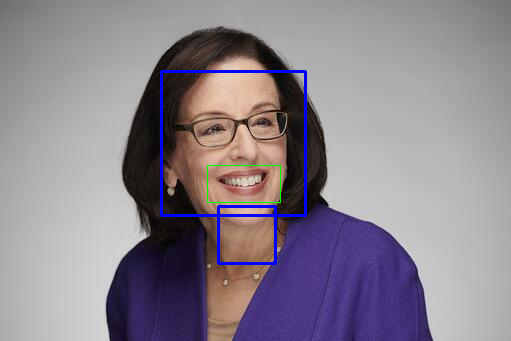

Laura Boudreau


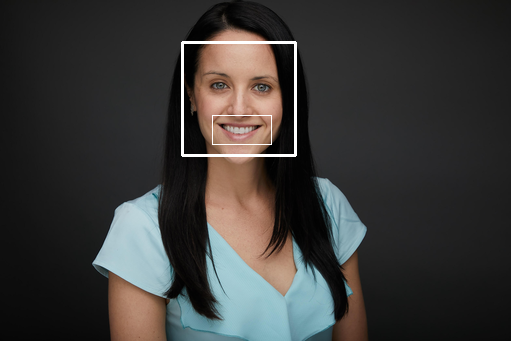

Abby Cohen


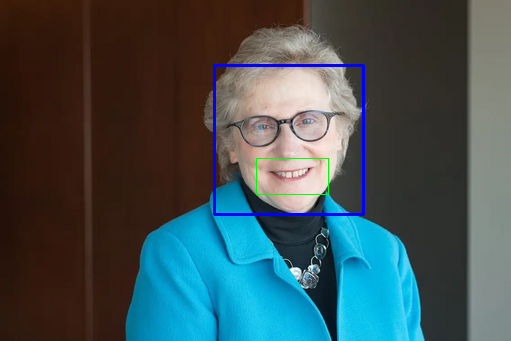

Wouter Dessein


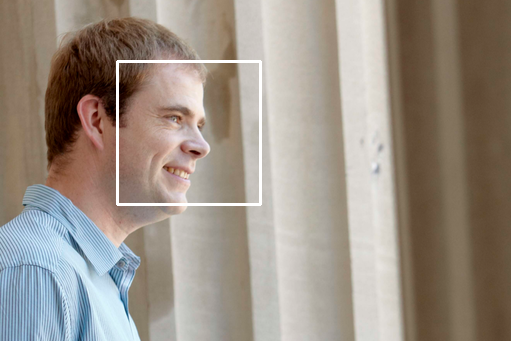

John Donaldson


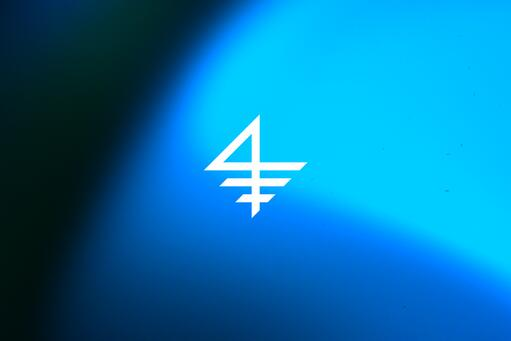

Laura Doval


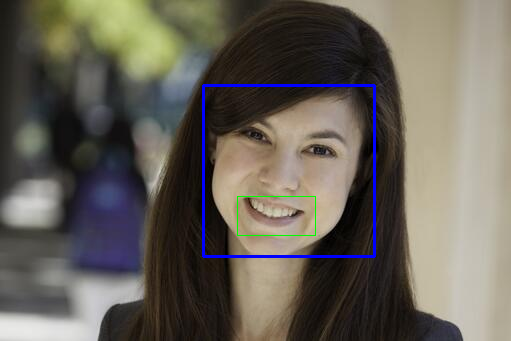

Frank Lichtenberg


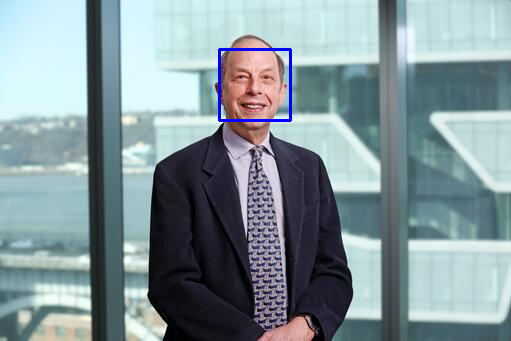

Kristina Manysheva


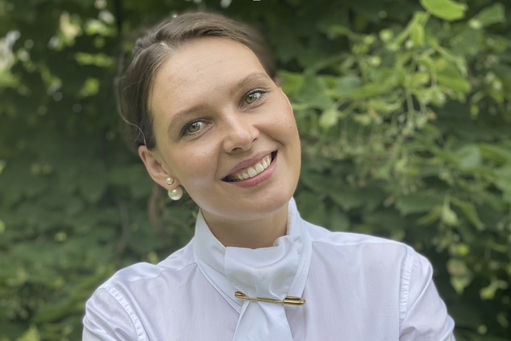

Frederic Mishkin


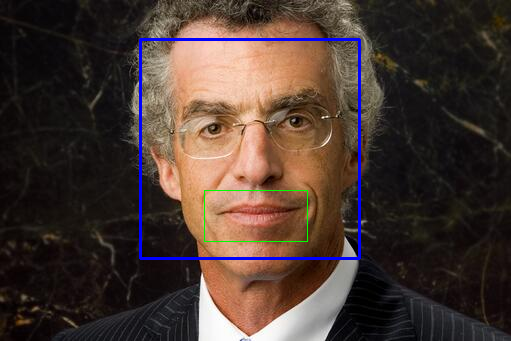

Christian Moser


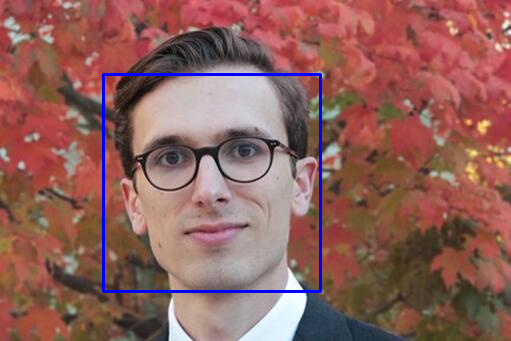

Cristóbal Otero


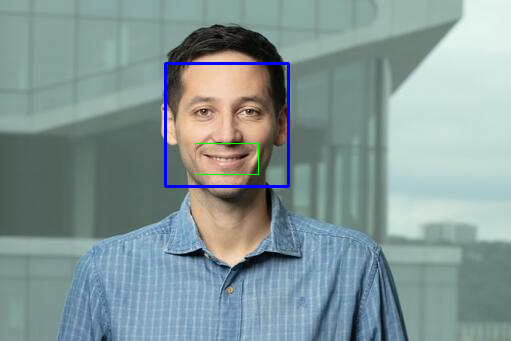

Jacopo Perego


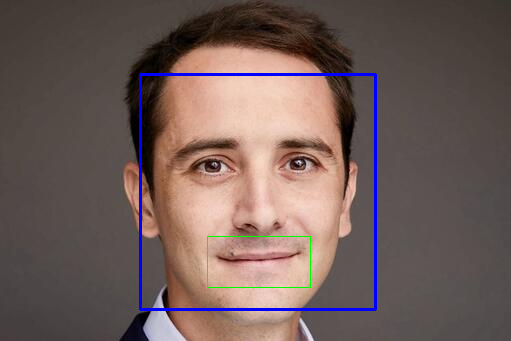

Tommaso Porzio


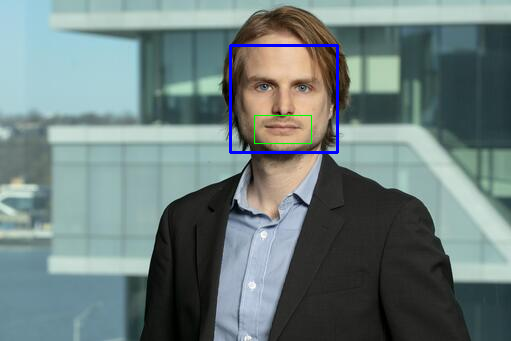

Andrea Prat


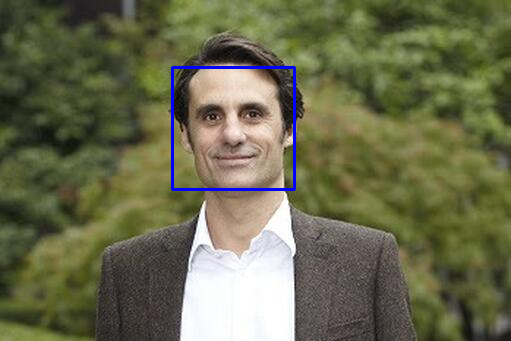

Jonah Rockoff


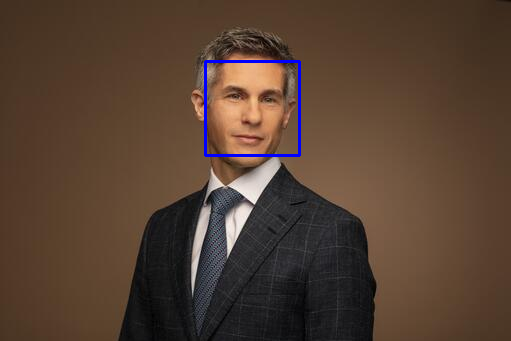

Jesse Schreger


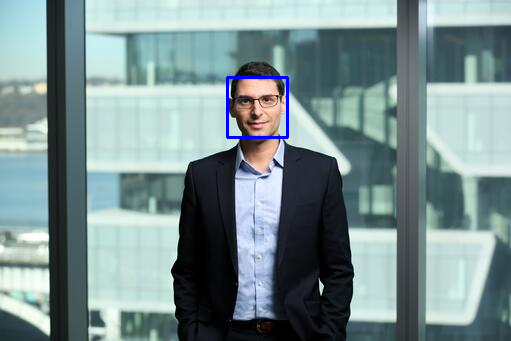

Nachum Sicherman


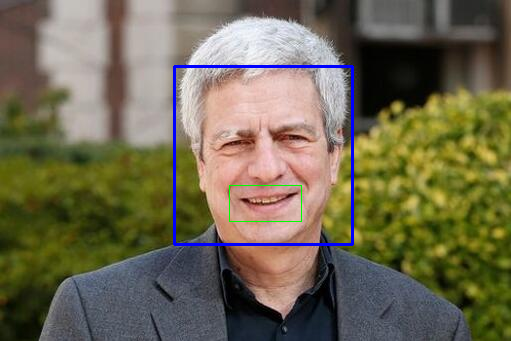

Paolo Siconolfi


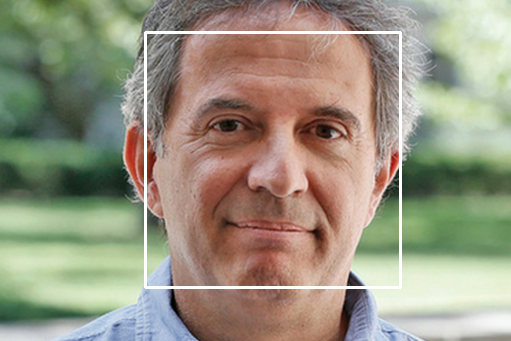

Joseph Stiglitz


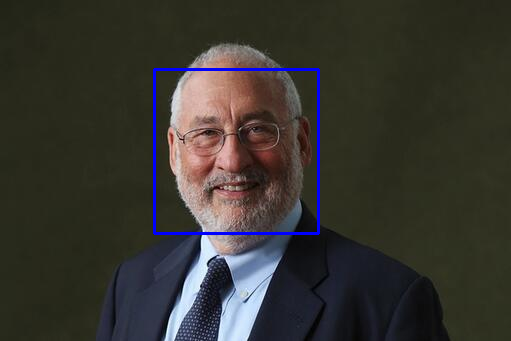

Conor Walsh


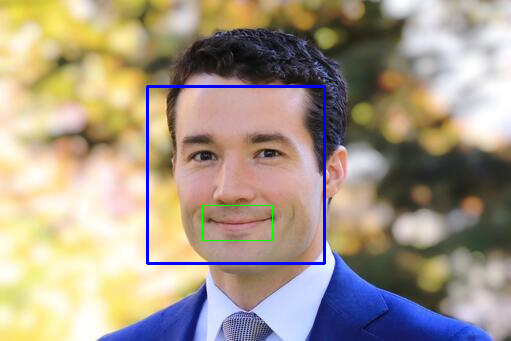

Shang-Jin Wei


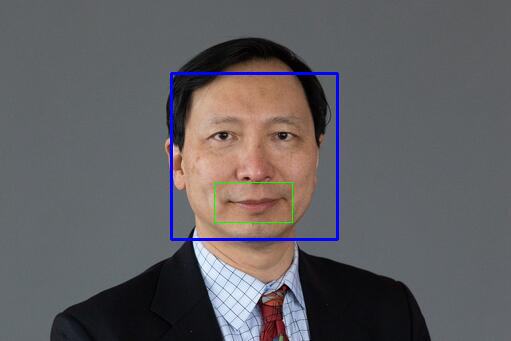

Maurice Wilkinson


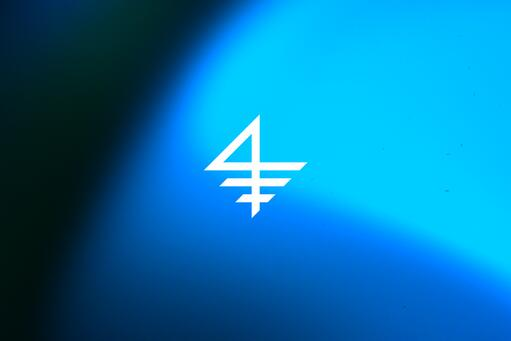

Pierre Yared


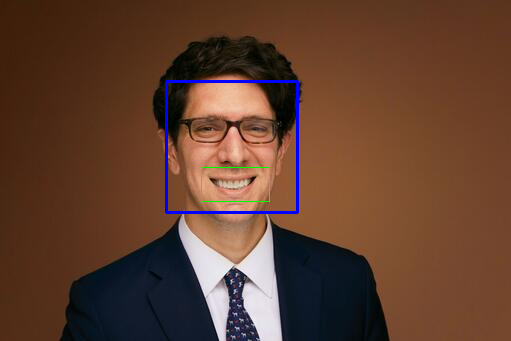

Stephen Zeldes


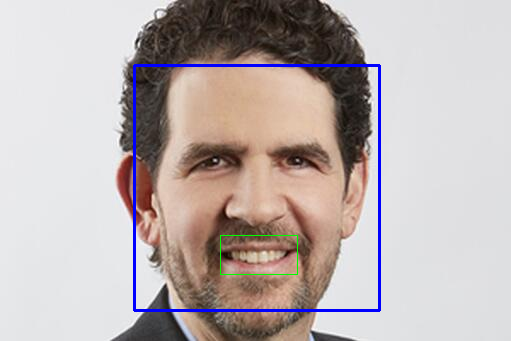

Mabel Abraham


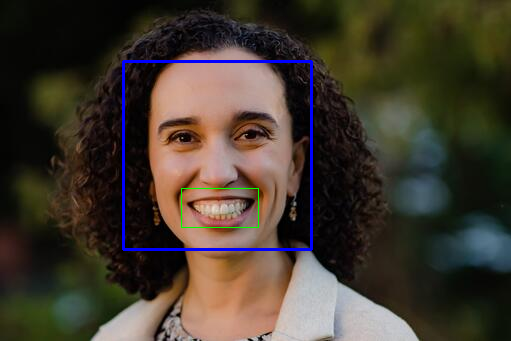

Eric Abrahamson


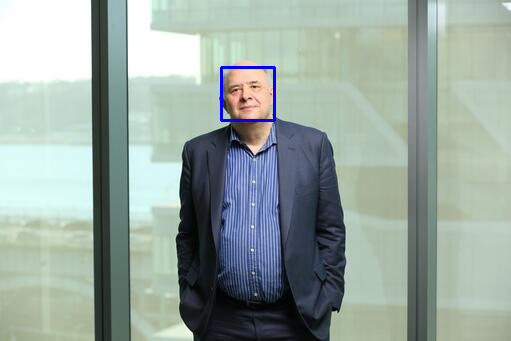

Modupe Akinola


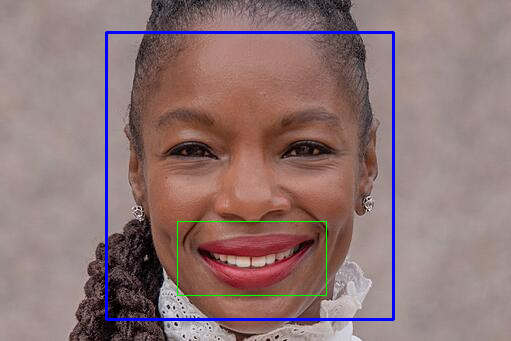

Daniel Ames


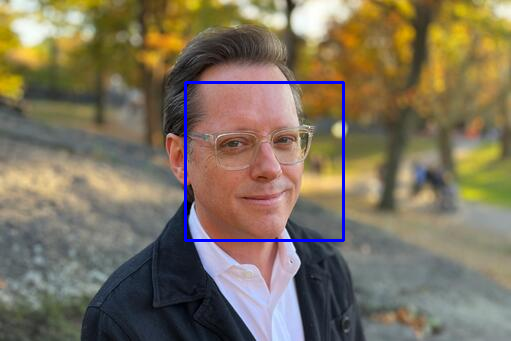

Joel Brockner


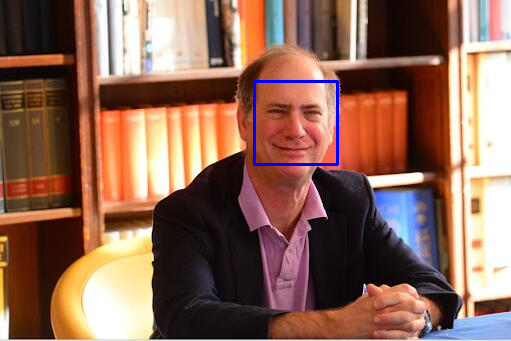

Derek Brown


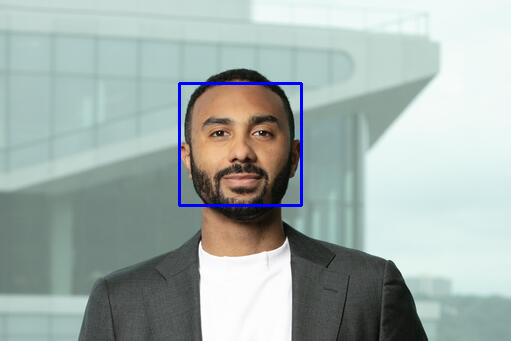

Vanessa Burbano


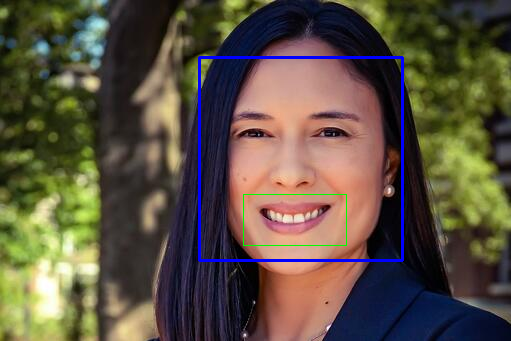

Bo Cowgill


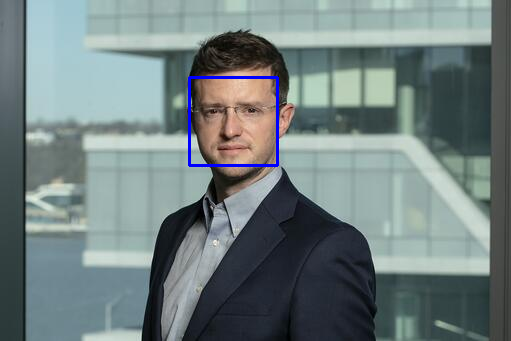

Shai Davidai


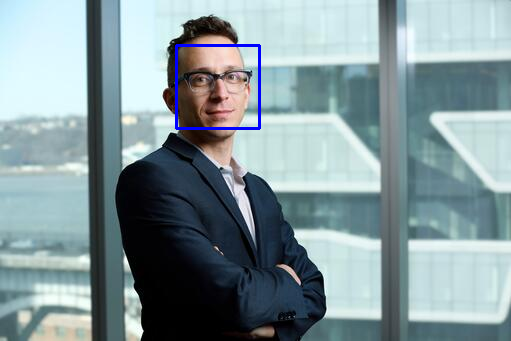

Adam Galinsky


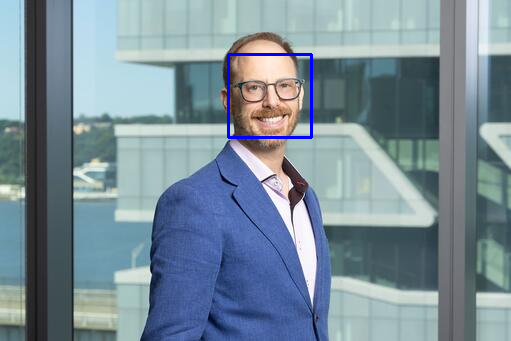

Jorge Guzman


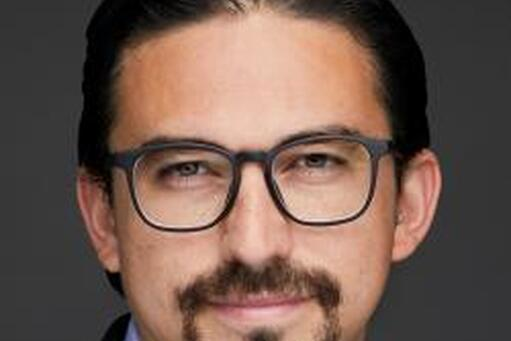

Kathryn Harrigan


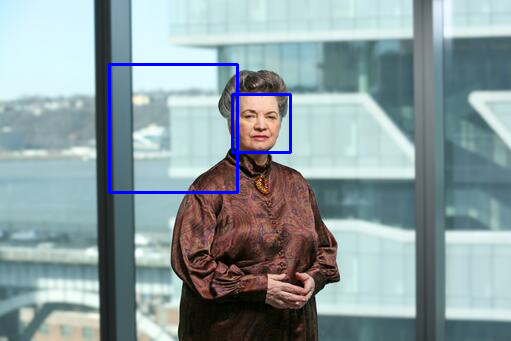

E. Tory Higgins


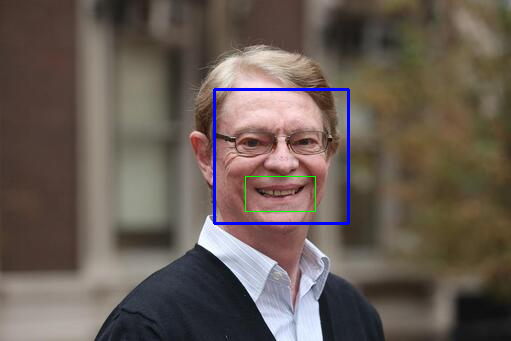

Paul Ingram


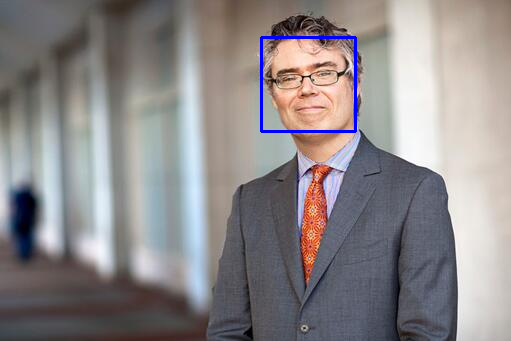

Sheena Iyengar


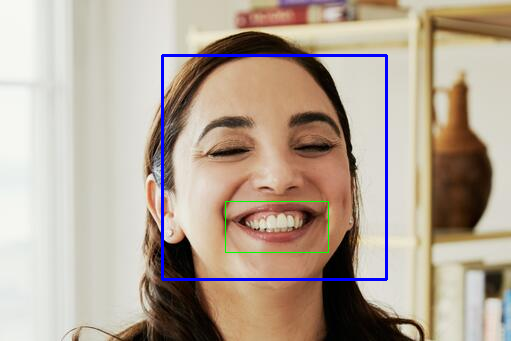

Daniel Keum


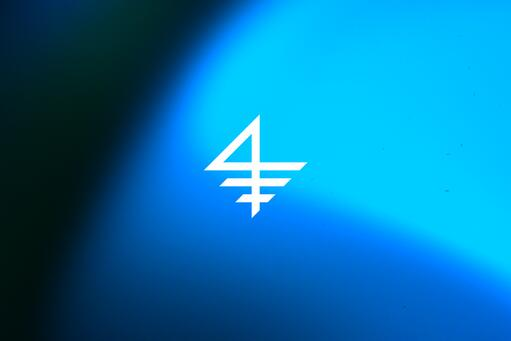

Soomi Kim


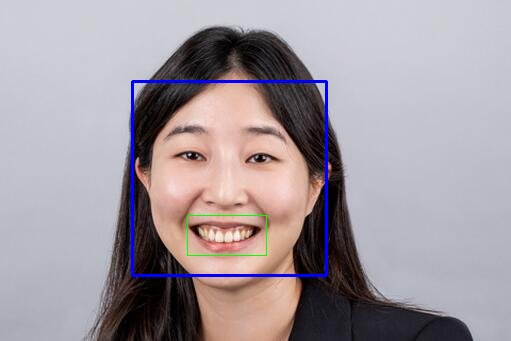

Bruce Kogut


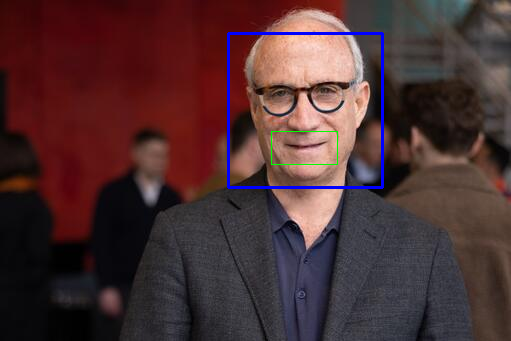

Malia Mason


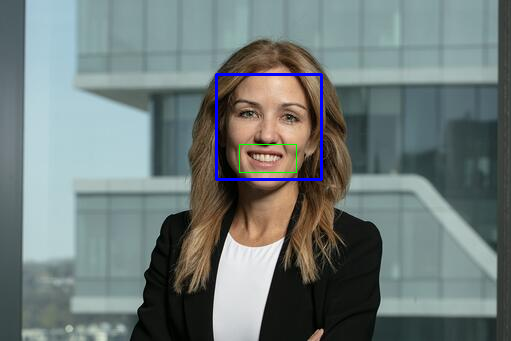

Sandra Matz


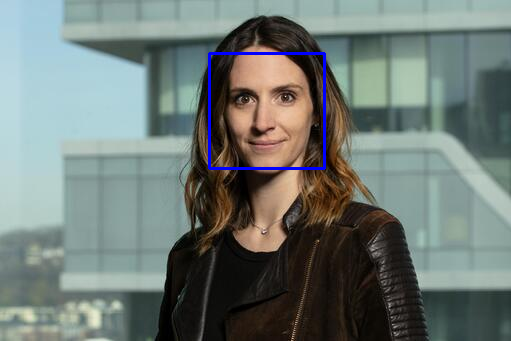

Michael Mauskapf


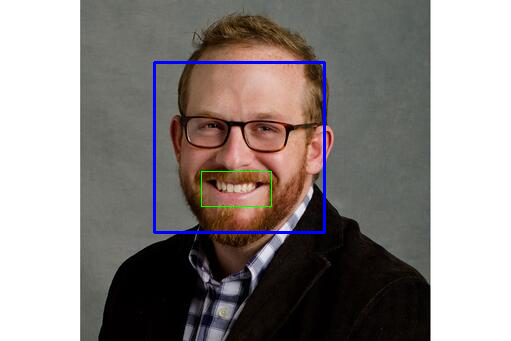

Stephan Meier


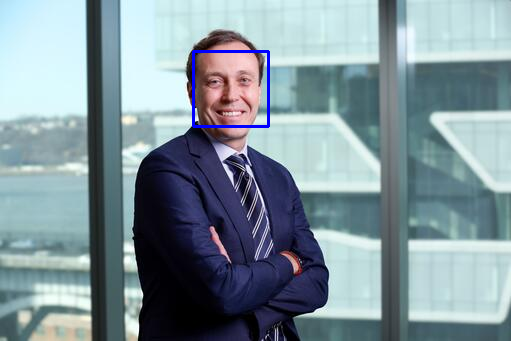

Michael Morris


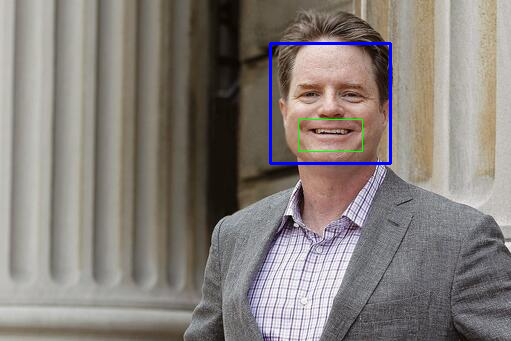

Rebecca Ponce de Leon


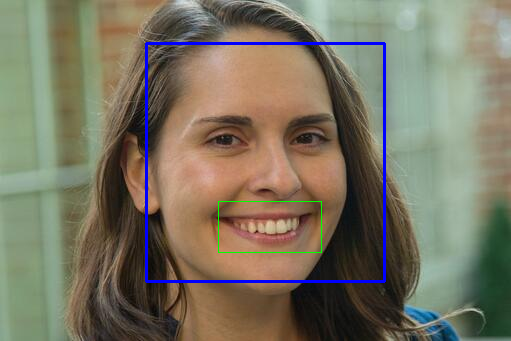

Michael Slepian


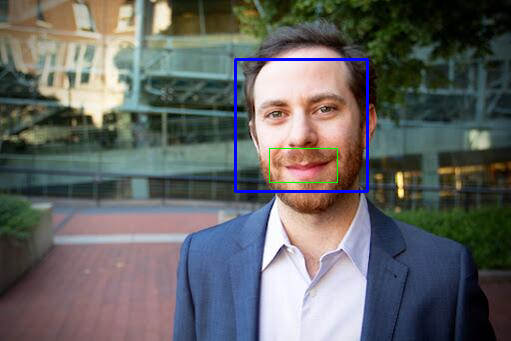

Adina D. Sterling


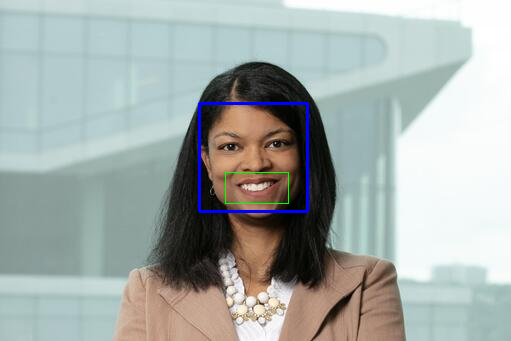

Dan Wang


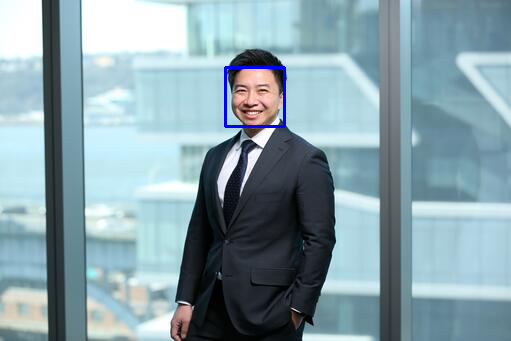

Nataliya L. Wright


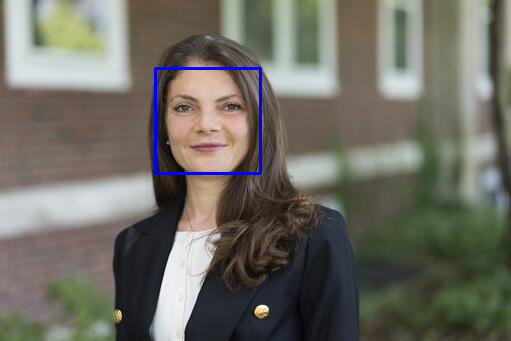

Lori Yue


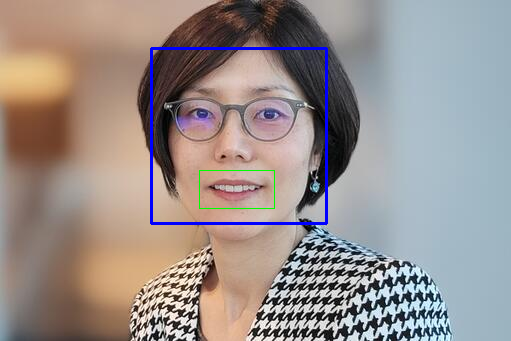

Santiago Balseiro


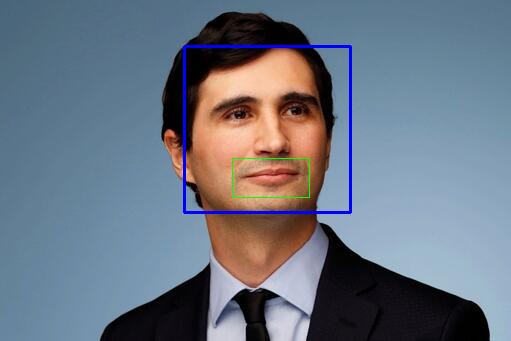

Omar Besbes


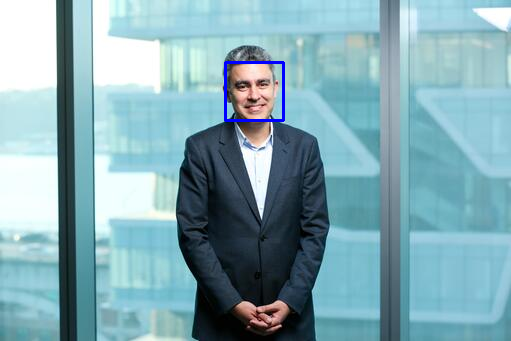

Mark Broadie


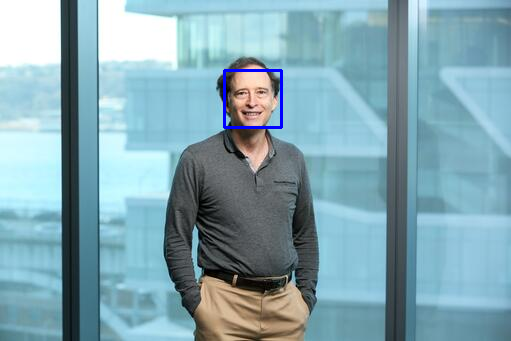

Carri Chan


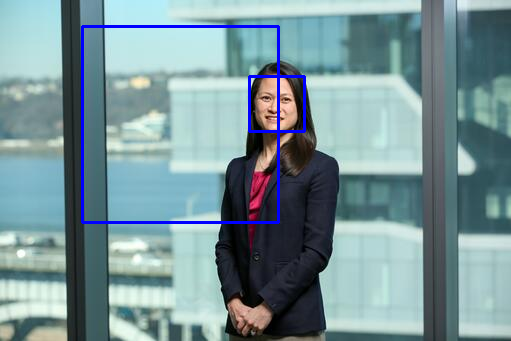

Jing Dong


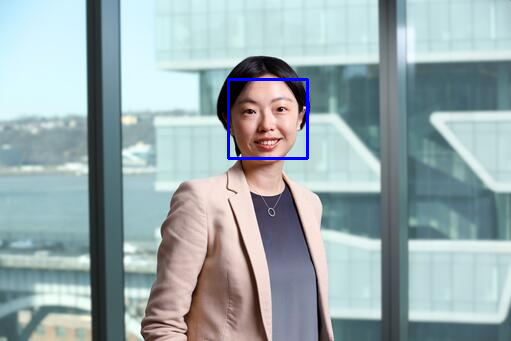

Awi Federgruen


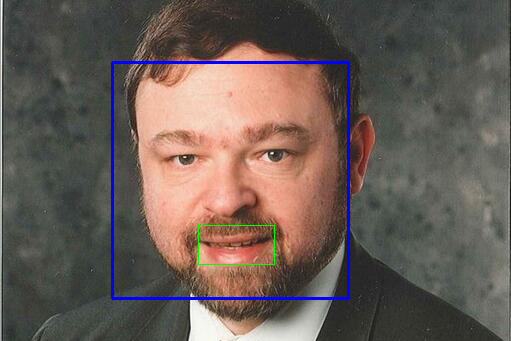

Paul Glasserman


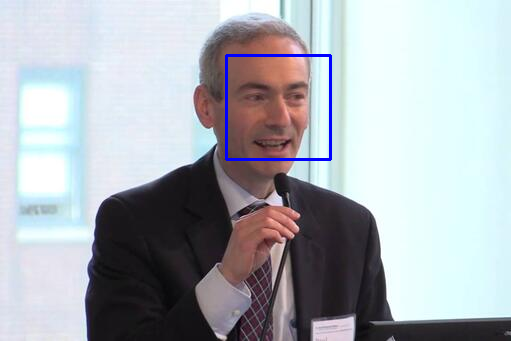

Yash Kanoria


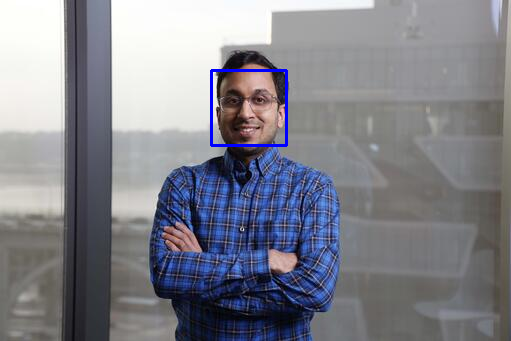

Hannah Li


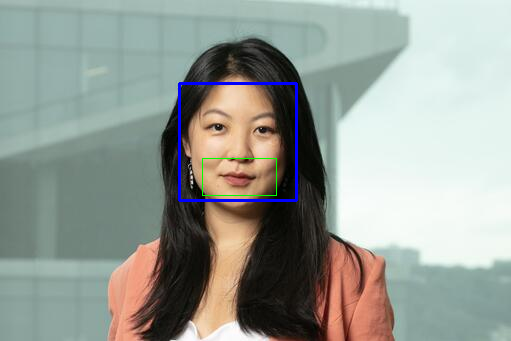

Will Ma


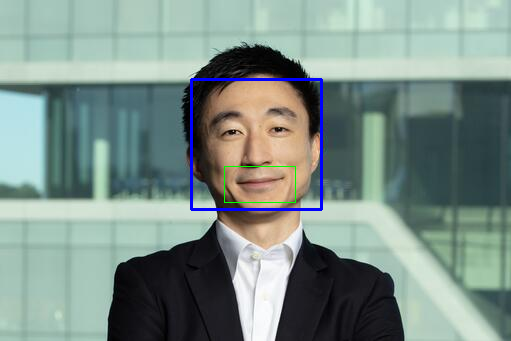

Hongyao Ma


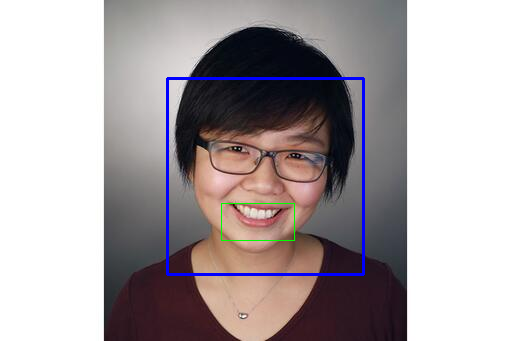

Costis Maglaras


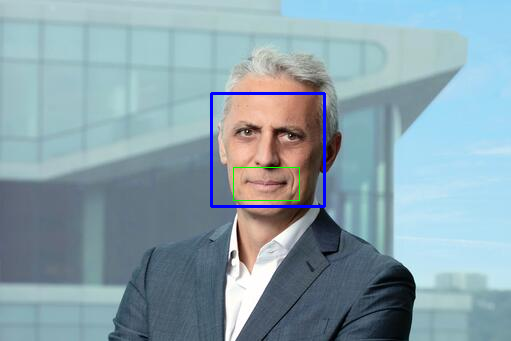

Ciamac Moallemi


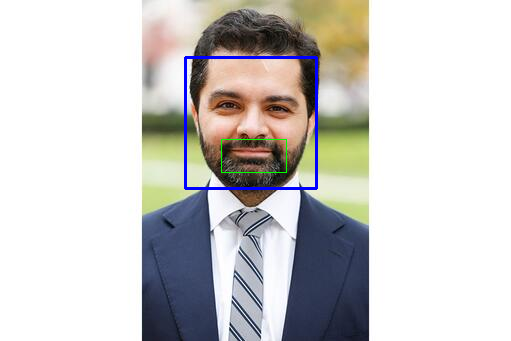

Hongseok Namkoong


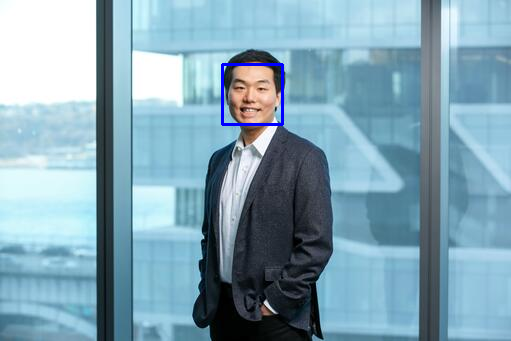

Nicola Rosaia


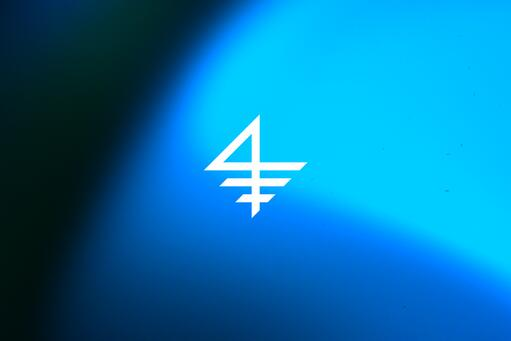

Daniel Russo


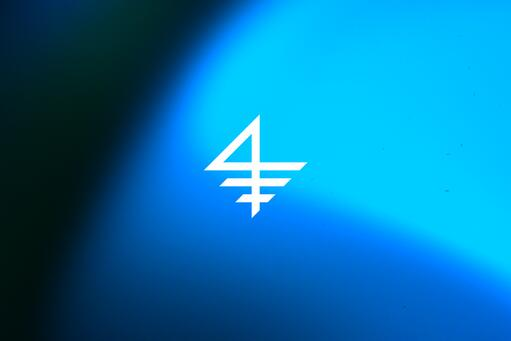

Assaf Zeevi


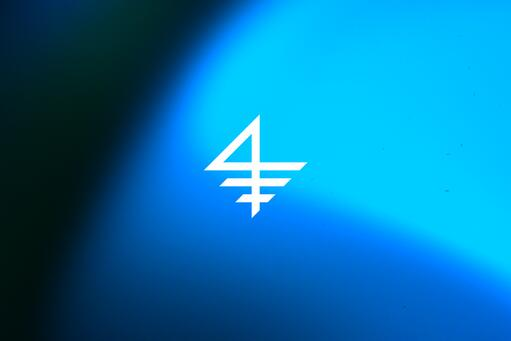

Asim Ansari


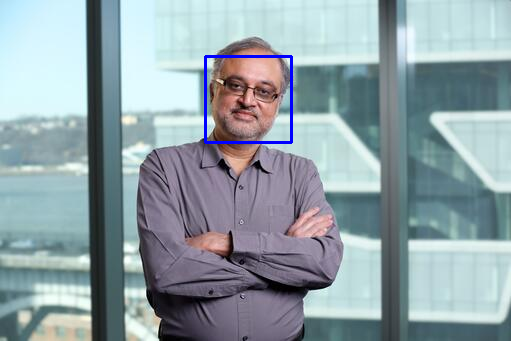

Silvia Bellezza


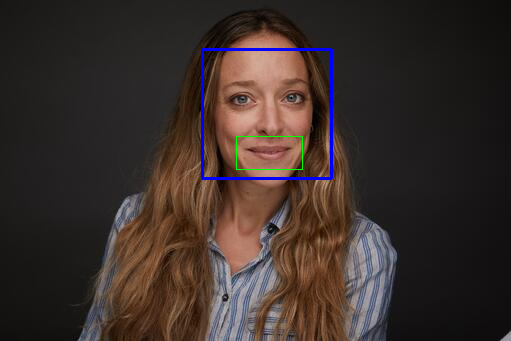

Melanie Brucks


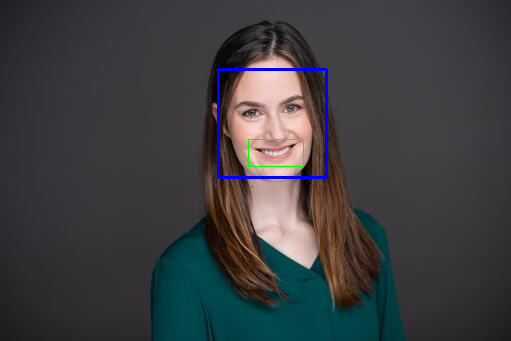

Noel Capon


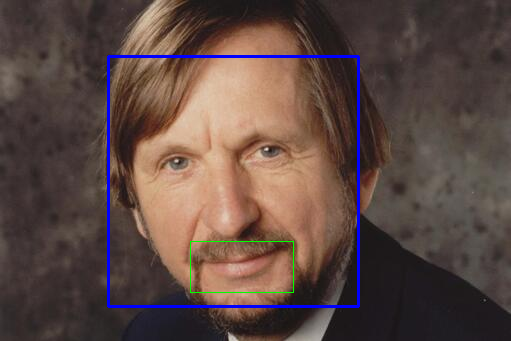

Dante Donati


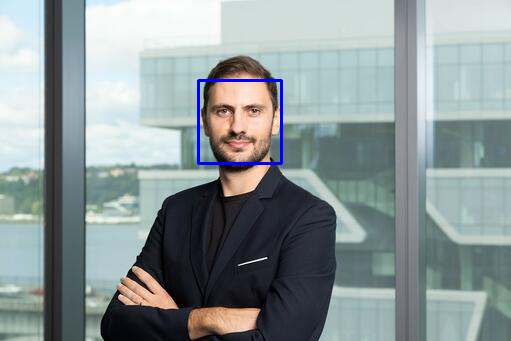

Hortense Fong


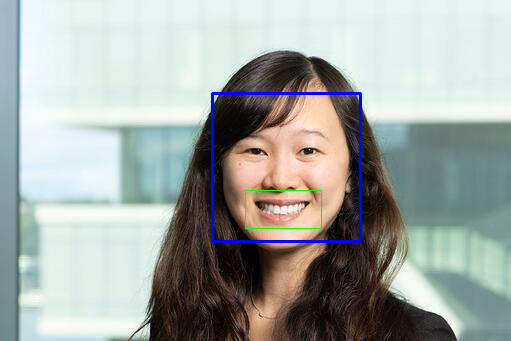

Elizabeth Friedman


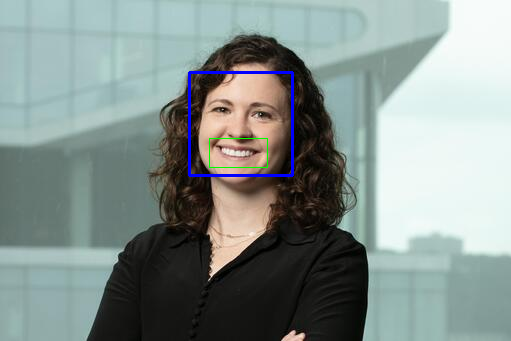

Kamel Jedidi


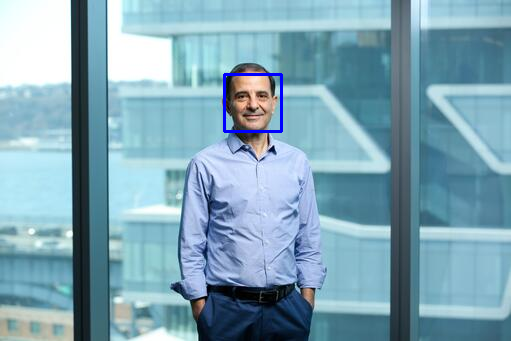

Kinshuk Jerath


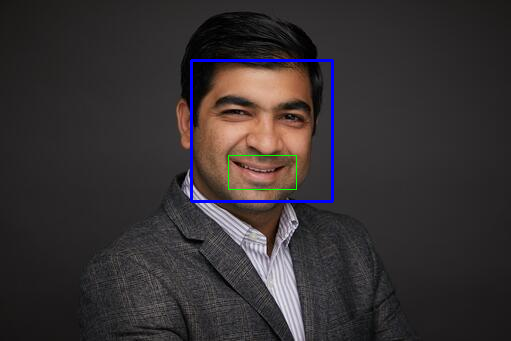

Gita Johar


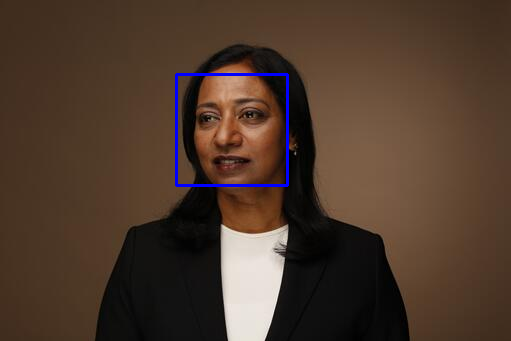

Eric Johnson


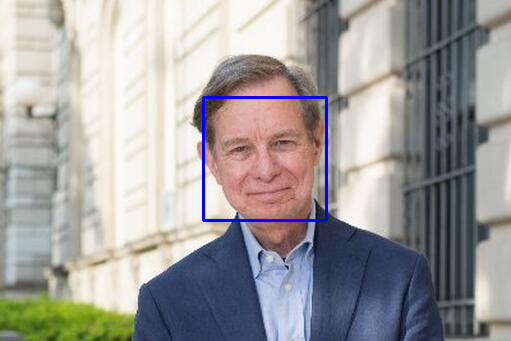

Ran Kivetz


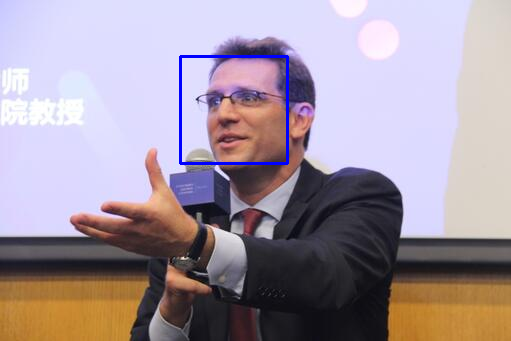

Rajeev Kohli


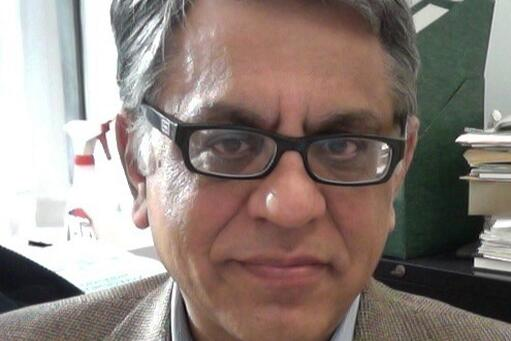

Vicki Morwitz


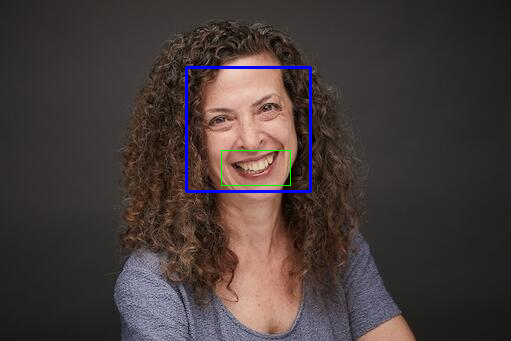

Oded Netzer


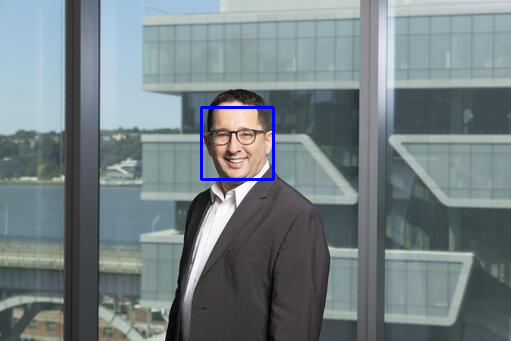

Michel Tuan Pham


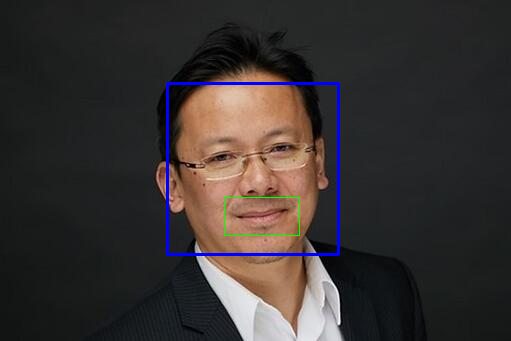

Miklos Sarvary


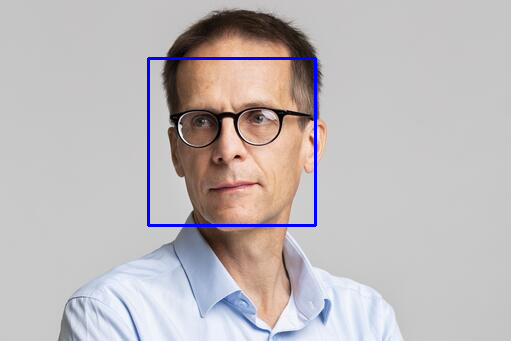

Bernd Schmitt


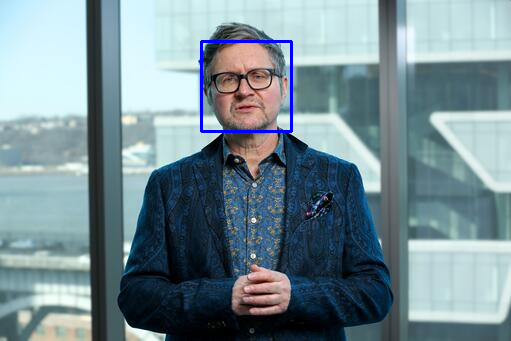

Andrey Simonov


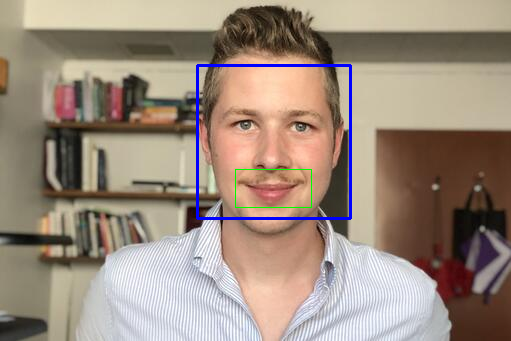

Olivier Toubia


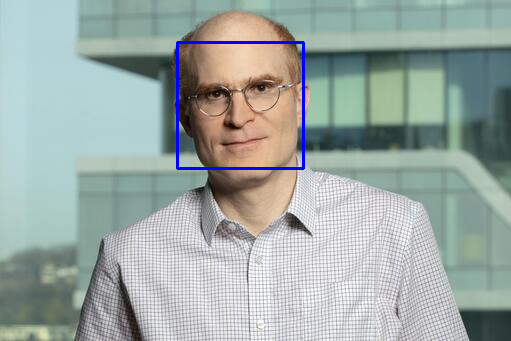

Tim Baldenius


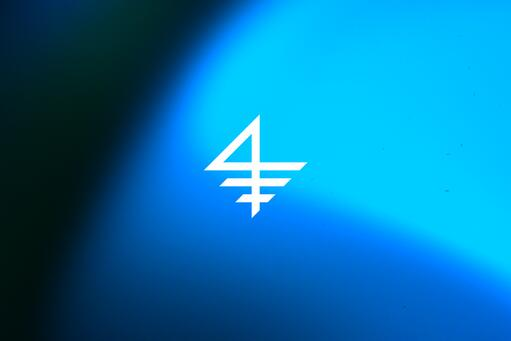

Thomas Bourveau


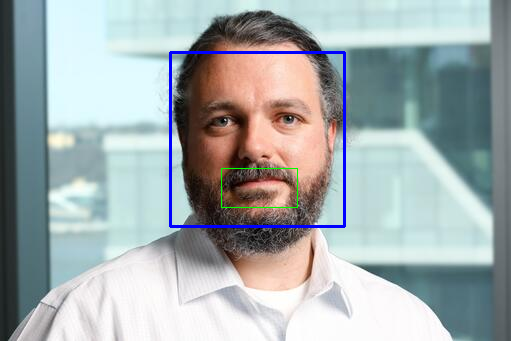

Matthias Breuer


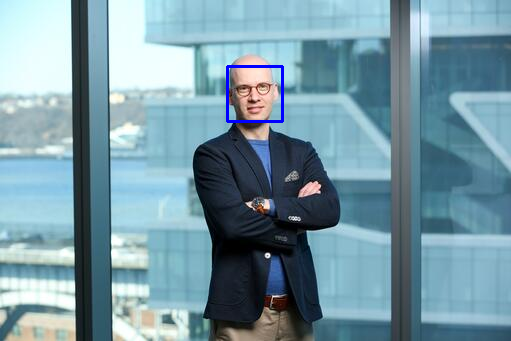

Wei Cai


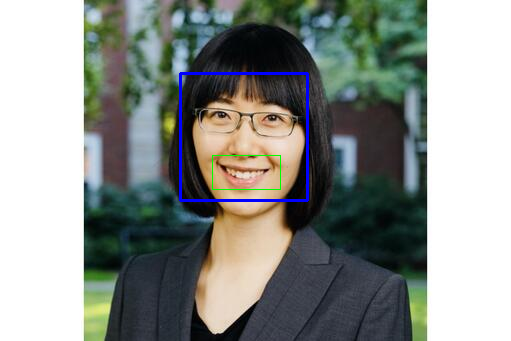

Jonathan Glover


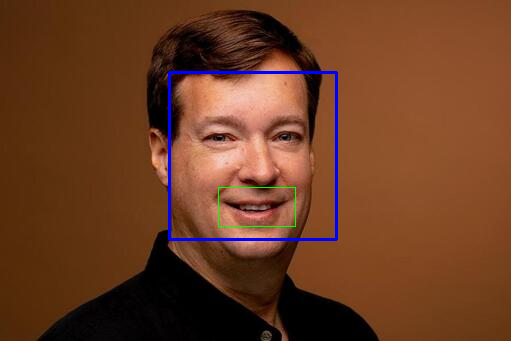

Anne Heinrichs


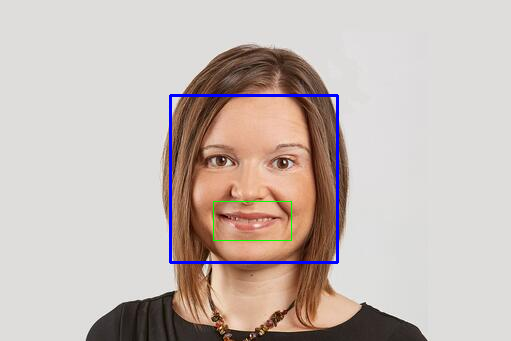

Kalash Jain


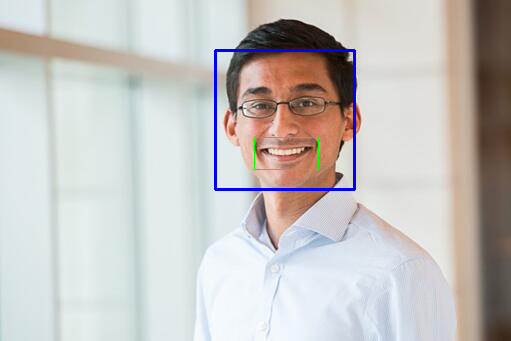

Sehwa Kim


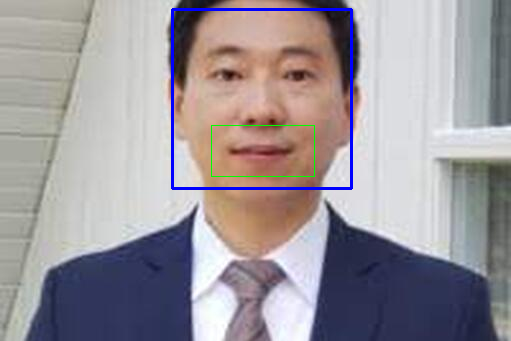

Lisa Liu


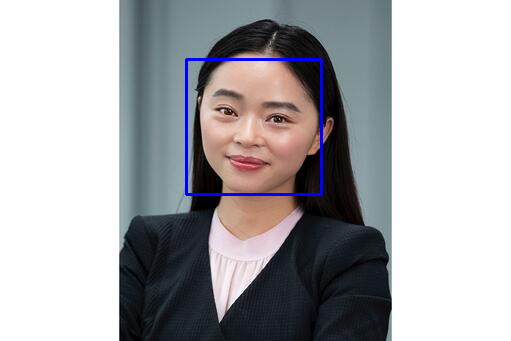

Doron Nissim


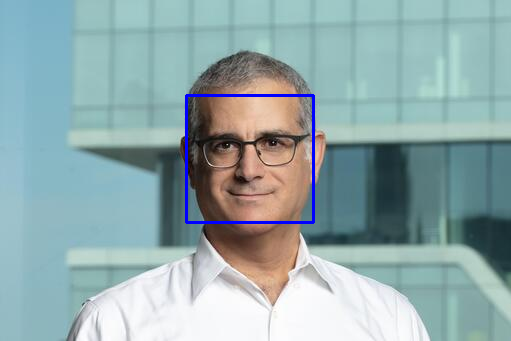

Shivaram Rajgopal


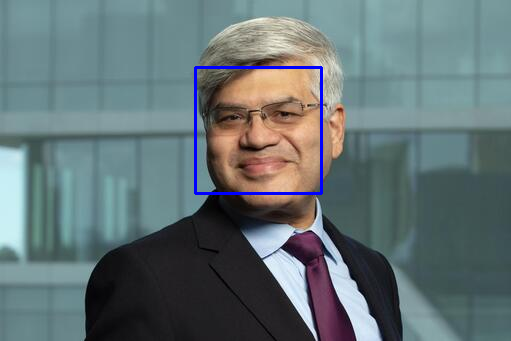

Syrena Shirley


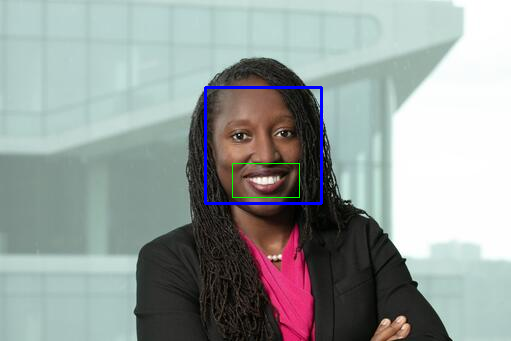

Sang Wu


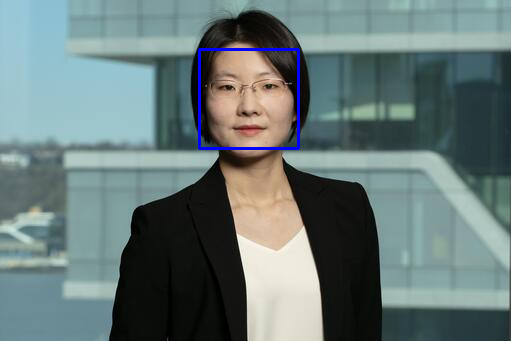

Boaz Abramson


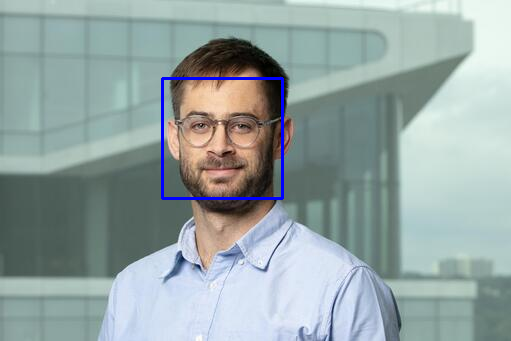

Tania Babina


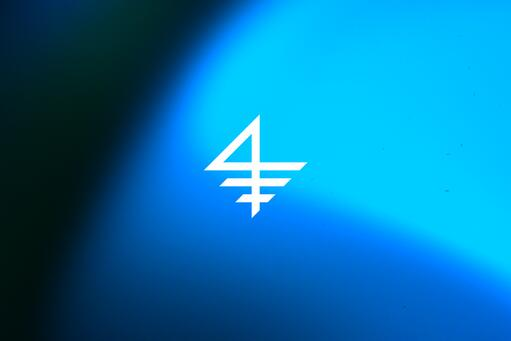

Geert Bekaert


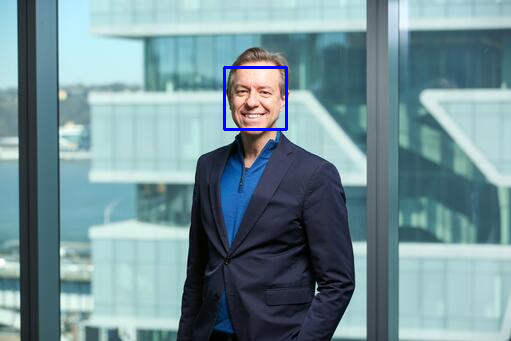

Kent Daniel


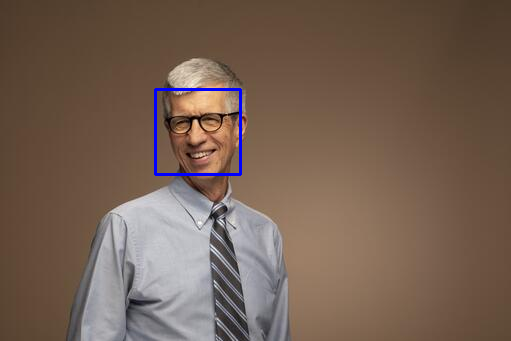

Olivier Darmouni


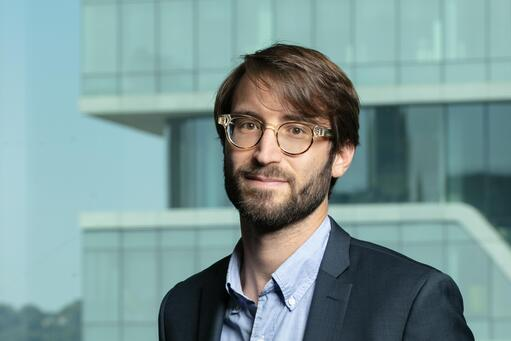

Wenxin Du


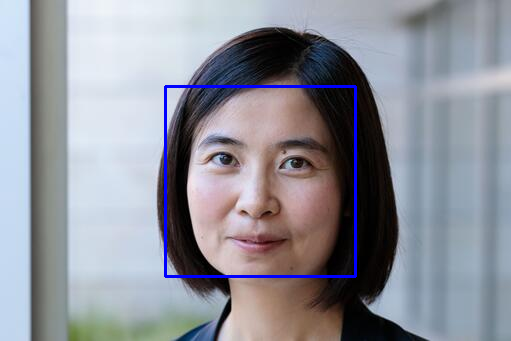

Michael Ewens


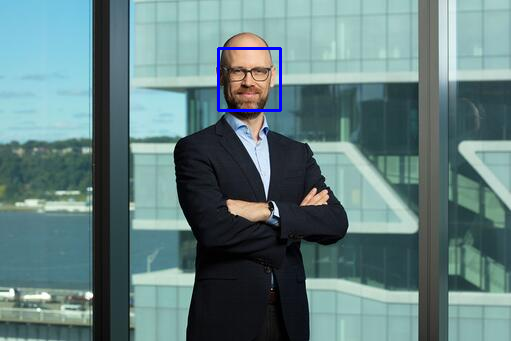

Xavier Giroud


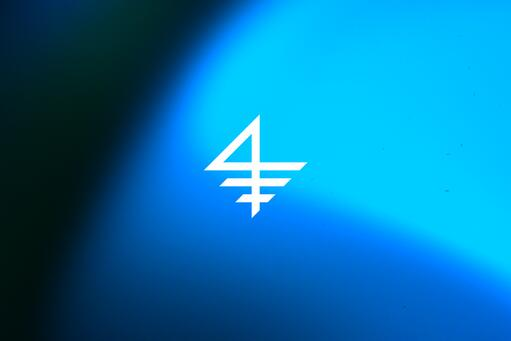

Gur Huberman


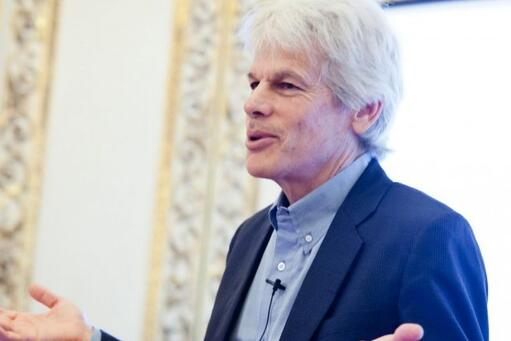

Michael Johannes


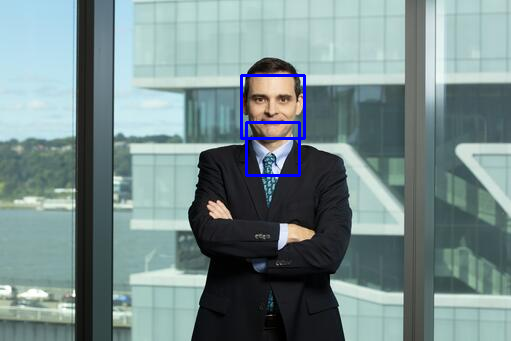

Jane (Jian) Li


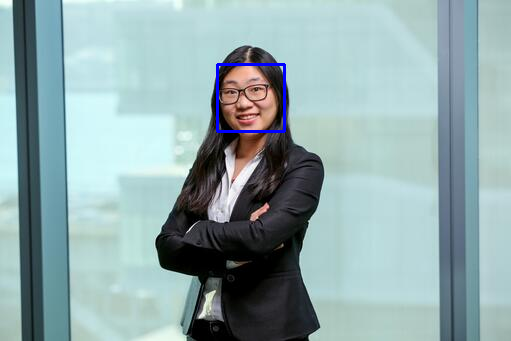

Xuelin Li


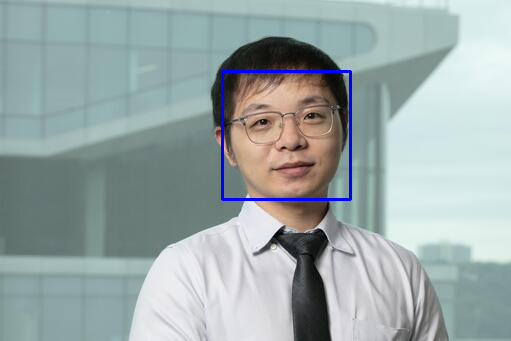

Yiming Ma


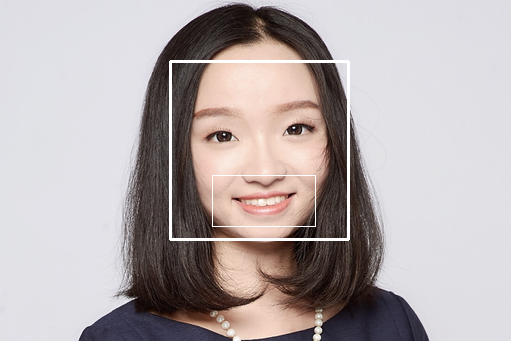

Christopher Mayer


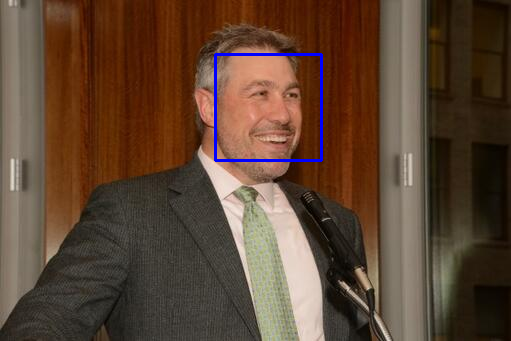

Tomasz Piskorski


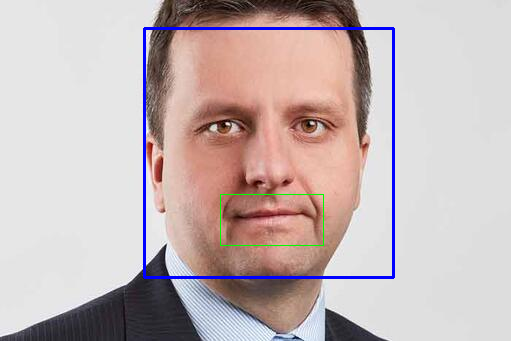

Tano Santos


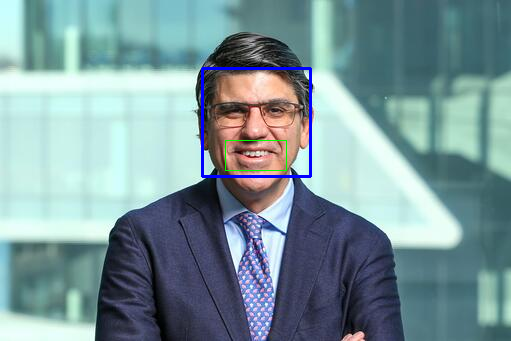

Parinitha Sastry


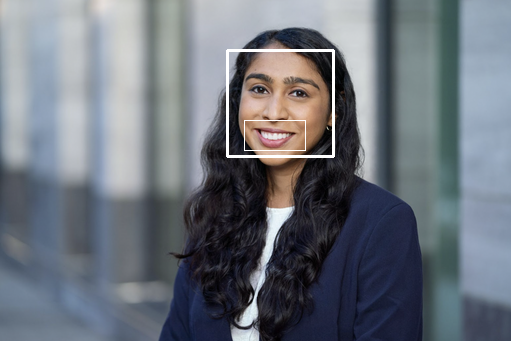

M. Suresh Sundaresan


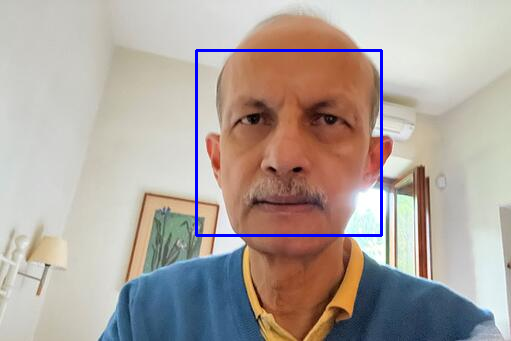

Dominik Supera


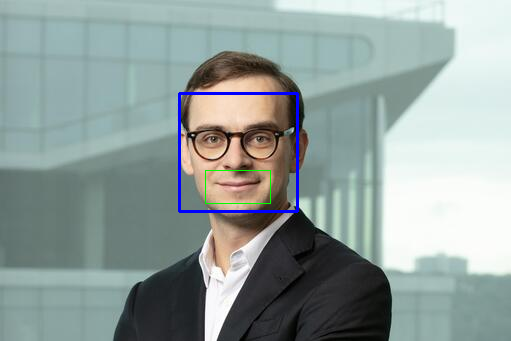

Paul Tetlock


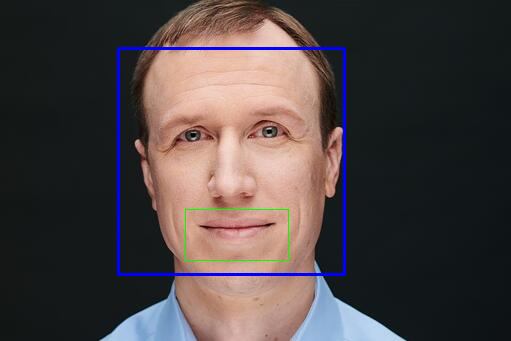

Stijn Van Nieuwerburgh


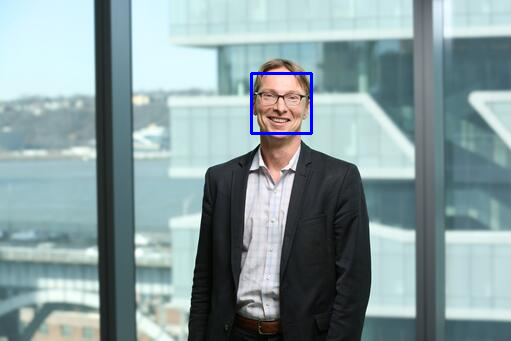

Laura Veldkamp


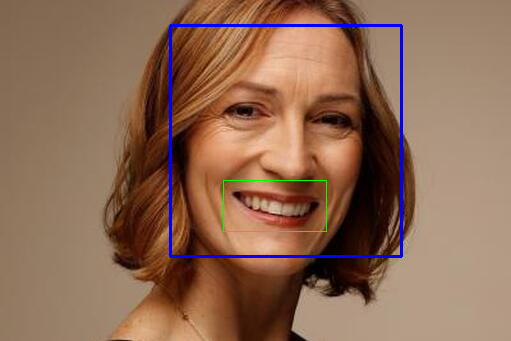

Neng Wang


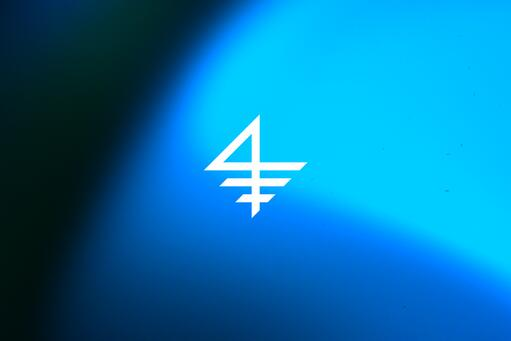

Daniel Wolfenzon


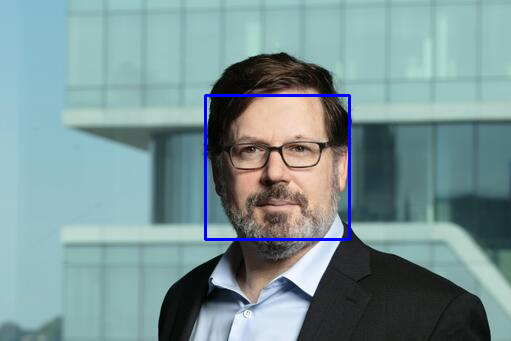

Kairong Xiao


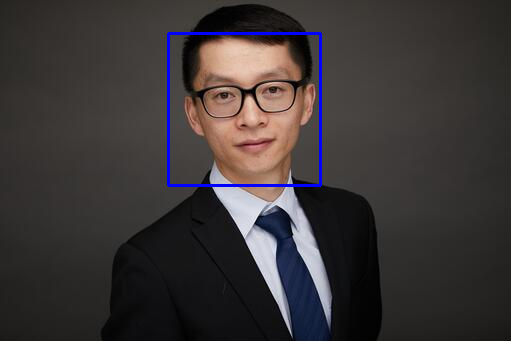

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

names = []
face_detected = []
smile_detected = []
re_files = []

for index, row in df_meta_prof2.iterrows():
    name = row["Name"]
    new_name = name.lower().replace(".", "").replace(" ", "_")
    filename = f"{new_name}.jpg"

    img = cv2.imread(f'/content/{filename}', -1)

    faces = face_cascade.detectMultiScale(img, scaleFactor=1.3, minNeighbors=5)
    #faces = face_cascade.detectMultiScale(img)

    if len(faces) > 0:
        face_var = 1
    else:
        face_var = 0

    for (x, y, w, h) in faces:
        # Draw rectangle around face
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_bottom_half = img[y + int(h * 0.6):y + h, x:x + w]

        # Check if the region of interest is not None
        if roi_bottom_half is not None:
            smiles = smile_cascade.detectMultiScale(roi_bottom_half, scaleFactor=1.3, minNeighbors=30)
            #smiles = smile_cascade.detectMultiScale(roi_bottom_half)

            if len(smiles) > 0:
                smile_var = 1
            else:
                smile_var = 0

            smile_coordinates = [(x + sx, y + int(h * 0.6) + sy, sw, sh) for (sx, sy, sw, sh) in smiles]
            # Calculate the bounding box for all smiles
            if smile_coordinates:
                min_x = min([x for (x, y, w, h) in smile_coordinates])
                min_y = min([y for (x, y, w, h) in smile_coordinates])
                max_w = max([x + w for (x, y, w, h) in smile_coordinates]) - min_x
                max_h = max([y + h for (x, y, w, h) in smile_coordinates]) - min_y

                # Draw a single larger rectangle around all smiles
                cv2.rectangle(img, (min_x, min_y), (min_x + max_w, min_y + max_h), (0, 255, 0), 1)


    save_filename = f'{new_name}_smile.jpg'
    re_files.append(save_filename)

    cv2.imwrite(save_filename, img)

    face_detected.append(face_var)
    smile_detected.append(smile_var)
    names.append(name)


    print(name)
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Kristina Manysheva(tilted head)


In [ ]:
df_smile = pd.DataFrame({"Name":names,
                         "Face":face_detected,
                         "Smile":smile_detected
                         })

df_smile.head()

print(df_smile["Face"].value_counts())
print(df_smile["Smile"].value_counts())

1    113
0     15
Name: Face, dtype: int64
0    69
1    59
Name: Smile, dtype: int64


In [ ]:
re_files

# Save the file as a zipfile
import zipfile
import os

zip_filename = '2024_columbia_images_with_smile.zip'

with zipfile.ZipFile(zip_filename, 'w') as zipf:
  for filename in re_files:
    #print(filename)
    zipf.write(filename)

from google.colab import files
files.download('/content/2024_columbia_images_with_smile.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Final Touch

In [ ]:
df_result = df_meta_prof.merge(df_smile, on="Name")

df_result["University"] = "Columbia"

df_result = df_result[["University","Name","Department","Rank","Sex","Title","Pronouns","URL","Face","Smile"]]

df_result.head(3)

df_result.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 128 entries, 0 to 127
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   University  128 non-null    object
 1   Name        128 non-null    object
 2   Department  128 non-null    object
 3   Rank        128 non-null    object
 4   Sex         128 non-null    object
 5   Title       128 non-null    object
 6   Pronouns    128 non-null    object
 7   URL         128 non-null    object
 8   Face        128 non-null    int64 
 9   Smile       128 non-null    int64 
dtypes: int64(2), object(8)
memory usage: 11.0+ KB


In [ ]:
print(df_result["Rank"].value_counts(), "\n")
print(df_result["Sex"].value_counts(), "\n")
print(df_result["Face"].value_counts(), "\n")
print(df_result["Smile"].value_counts(), "\n")

Full         70
Assistant    33
Associate    25
Name: Rank, dtype: int64 

Male      90
Female    38
Name: Sex, dtype: int64 

1    113
0     15
Name: Face, dtype: int64 

0    69
1    59
Name: Smile, dtype: int64 



In [ ]:
df_result = df_result[df_result["Rank"] != "Emeritus"]
df_result = df_result[df_result["Sex"] != "Unknown"]
df_result = df_result[df_result["Face"] == 1]

df_result.to_csv("2024_01_Columbia_Smile.csv", index=False)
df_result.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113 entries, 0 to 127
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   University  113 non-null    object
 1   Name        113 non-null    object
 2   Department  113 non-null    object
 3   Rank        113 non-null    object
 4   Sex         113 non-null    object
 5   Title       113 non-null    object
 6   Pronouns    113 non-null    object
 7   URL         113 non-null    object
 8   Face        113 non-null    int64 
 9   Smile       113 non-null    int64 
dtypes: int64(2), object(8)
memory usage: 9.7+ KB


In [ ]:
df = df_result

from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df["Rank"], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile       0   1
Rank             
Assistant  12  18
Associate   7  14
Full       38  24 

Chi-square statistic: 6.6862977335812666
P-value: 0.03532554696314321
Degrees of freedom: 2
Expected frequencies:
[[15.13274336 14.86725664]
 [10.59292035 10.40707965]
 [31.27433628 30.72566372]]


In [ ]:
df = df_result

from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df["Sex"], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile    0   1
Sex           
Female  11  25
Male    46  31 

Chi-square statistic: 7.231615773967748
P-value: 0.00716307091162964
Degrees of freedom: 1
Expected frequencies:
[[18.15929204 17.84070796]
 [38.84070796 38.15929204]]
